## Importing Libraries



In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from skimage.transform import resize
from keras.utils.vis_utils import plot_model
import imageio
import glob
import pathlib, os
import cv2
from tensorflow import keras
from tensorflow.keras import layers, Sequential
from tensorflow.keras.preprocessing import image_dataset_from_directory 


Init Plugin
Init Graph Optimizer
Init Kernel


## Data Loading and Visualization

In [2]:
# Defining the path for the data
base_dir = pathlib.Path("/Users/akansha/Documents/data science/gan/MRI+T1_T2+Dataset")
os.chdir(base_dir)

data_dir_T1 = pathlib.Path(str(base_dir) + "/Tr1/TrainT1")
data_dir_T2 = pathlib.Path(str(base_dir) + "/Tr2/TrainT2")

print("Path for T1 data :\n", data_dir_T1)
print("Path for T2 data :\n", data_dir_T2)

Path for T1 data :
 /Users/akansha/Documents/data science/gan/MRI+T1_T2+Dataset/Tr1/TrainT1
Path for T2 data :
 /Users/akansha/Documents/data science/gan/MRI+T1_T2+Dataset/Tr2/TrainT2


#### T1 Image Visualization

In [3]:
img_T1 = cv2.imread(str(data_dir_T1)+"/Image #10.png")
img_T1.shape

(217, 181, 3)

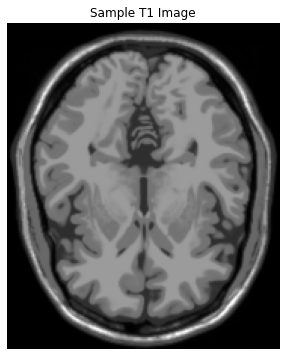

In [4]:
plt.figure(figsize=(6, 6))
plt.imshow(img_T1)
plt.title("Sample T1 Image")
plt.axis('off')
plt.show()

#### T2 Image Visualization

In [5]:
img_T2 = cv2.imread(str(data_dir_T2)+"/Image #100.png")
img_T2.shape

(217, 181, 3)

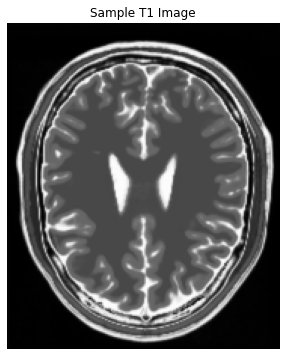

In [6]:
plt.figure(figsize=(6, 6))
plt.imshow(img_T2)
plt.title("Sample T1 Image")
plt.axis('off')
plt.show()

#### Creating dataset

In [7]:
image_count_T1 = len(list(data_dir_T1.glob('*.png')))
print("No. of images in T1 dataset: ", image_count_T1)
image_count_T2 = len(list(data_dir_T2.glob('*.png')))
print("No. of images in T2 dataset: ", image_count_T2)

No. of images in T1 dataset:  43
No. of images in T2 dataset:  46


In [8]:
IMG_HEIGHT = 217
IMG_WIDTH = 181
BATCH_SIZE = 64

In [9]:
df_images_T1 = image_dataset_from_directory(data_dir_T1, seed = 123, shuffle = True, labels = None,
                                         image_size=(IMG_HEIGHT, IMG_WIDTH), batch_size=BATCH_SIZE)

Found 43 files belonging to 1 classes.
Metal device set to: Apple M1


2022-05-02 21:39:02.911308: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-05-02 21:39:02.911682: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [10]:
df_images_T2 = image_dataset_from_directory(data_dir_T2, seed = 123, shuffle = True, labels = None,
                                         image_size=(IMG_HEIGHT, IMG_WIDTH), batch_size=BATCH_SIZE)

Found 46 files belonging to 1 classes.


## Data Preprocessing
1. Data Normalization
2. Data Resizing
3. Data Reshaping
4. Batch and Shuffle Data

#### Normalizing T1 Images

In [11]:
normalization_layer = layers.experimental.preprocessing.Rescaling(scale = 1./127.5, offset =-1.0)

In [12]:
images_norm_T1 = df_images_T1.map(lambda x: (normalization_layer(x)))
image_batch1_T1 = next(iter(images_norm_T1))
norm_image_T1 = image_batch1_T1[0]
print("Minimum and maximum pixel values after normalization")
print(np.min(norm_image_T1), np.max(norm_image_T1))

Minimum and maximum pixel values after normalization
-1.0 1.0


2022-05-02 21:39:02.985080: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2022-05-02 21:39:02.985237: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


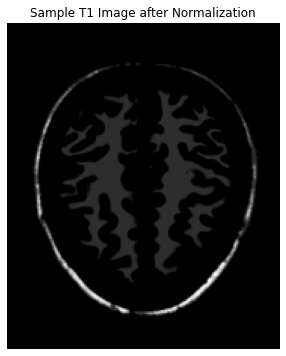

In [13]:
plt.figure(figsize=(6, 6))
plt.imshow(norm_image_T1)
plt.title("Sample T1 Image after Normalization")
plt.axis('off')
plt.show()

#### Normalizing T2 images

In [14]:
images_norm_T2 = df_images_T2.map(lambda x: (normalization_layer(x)))
image_batch1_T2 = next(iter(images_norm_T2))
norm_image_T2 = image_batch1_T2[0]
print("Minimum and maximum pixel values after normalization")
print(np.min(norm_image_T2), np.max(norm_image_T2))
print(norm_image_T2.shape)

Minimum and maximum pixel values after normalization
-1.0 1.0
(217, 181, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


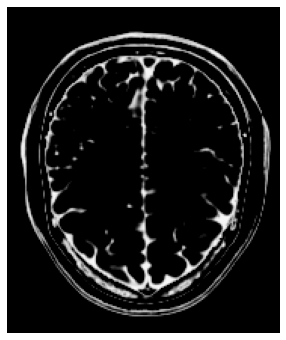

In [15]:
plt.figure(figsize=(6, 6))
plt.imshow(norm_image_T2)
plt.axis('off')
plt.show()

#### Resizing Images

In [16]:
resize_layer = layers.experimental.preprocessing.Resizing(128, 128, interpolation='bilinear')

In [17]:
images_resize_T1 = images_norm_T1.map(lambda x: (resize_layer(x)))
image_batch1_T1 = next(iter(images_resize_T1))
resize_image_T1 = image_batch1_T1[0]
print("Size of Image after Resizing")
print(resize_image_T1.shape)
image_batch1_T1.shape

Size of Image after Resizing
(128, 128, 3)


TensorShape([43, 128, 128, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


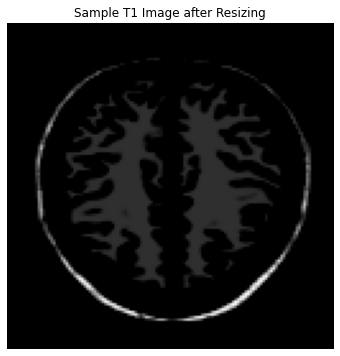

In [18]:
plt.figure(figsize=(6, 6))
plt.imshow(resize_image_T1)
plt.title("Sample T1 Image after Resizing")
plt.axis('off')
plt.show()

In [19]:
images_resize_T2 = images_norm_T2.map(lambda x: (resize_layer(x)))
image_batch1_T2 = next(iter(images_resize_T2))
resize_image_T2 = image_batch1_T2[0]
print("Size of Image after Resizing")
print(resize_image_T2.shape)
image_batch1_T2.shape

Size of Image after Resizing
(128, 128, 3)


TensorShape([46, 128, 128, 3])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


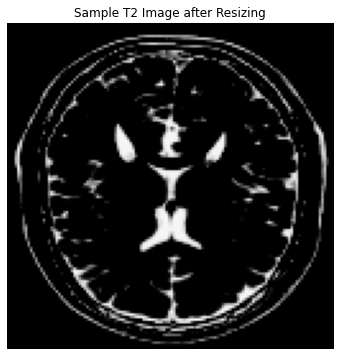

In [20]:
plt.figure(figsize=(6, 6))
plt.imshow(resize_image_T2)
plt.title("Sample T2 Image after Resizing")
plt.axis('off')
plt.show()

#### Reshaping data to Single channel

In [21]:
reshape_layer = layers.Reshape((128,128,1))

In [22]:
images_reshape_T1 = images_resize_T1.map(lambda x : reshape_layer(x[:,:,:,0]))
image_batch1_T1 = next(iter(images_reshape_T1))
reshape_image_T1 = image_batch1_T1[0]
print("Size of Image after Reshaping to Single Channel")
print(reshape_image_T1.shape)

Size of Image after Reshaping to Single Channel
(128, 128, 1)


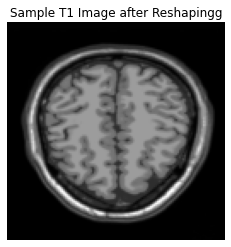

In [23]:

plt.imshow(reshape_image_T1.numpy()[:, :, 0], cmap='gray')
plt.title("Sample T1 Image after Reshapingg")
plt.axis('off')
plt.show()

In [24]:
images_reshape_T2 = images_resize_T2.map(lambda x : reshape_layer(x[:,:,:,0]))
image_batch1_T2 = next(iter(images_reshape_T2))
reshape_image_T2 = image_batch1_T2[0]
print("Size of Image after Reshaping to Single Channel")
print(reshape_image_T2.shape)

Size of Image after Reshaping to Single Channel
(128, 128, 1)


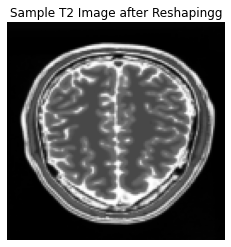

In [25]:
plt.imshow(reshape_image_T2.numpy()[:, :, 0], cmap='gray')
plt.title("Sample T2 Image after Reshapingg")
plt.axis('off')
plt.show()

#### Reshuffle Data



In [26]:
BUFFER_SIZE = 64
T1_data = images_reshape_T1.shuffle(BUFFER_SIZE)
T2_data = images_reshape_T2.shuffle(BUFFER_SIZE)

### Model Building
1. Instance Normalization
2. Downsampling, Upsampling and Unet
3. Generator Building using Unet
4. Discriminator Building



#### Instance Normalization
Instance Normalization are specially used with Style Transfer, where Separate Normalization is performed for each sample we perform channelwise Normalization.

In [27]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5):
        # calling parent's init
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

#### Downsampling

In [28]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Leaky Relu Activation
    result.add(tf.keras.layers.LeakyReLU())
    return result


#### Upsampling

In [29]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

#### UNets

In [30]:
# Unet Generator is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    down_stack = [
        downsample(64, 4, True), # (bs, 64, 64, 64)
        downsample(64, 4),        # (bs, 32, 32, 64)
        downsample(128, 4),       # (bs, 16, 16, 128)
        downsample(128, 4),       # (bs, 8, 8, 128)
        downsample(256, 4),       # (bs, 4, 4, 256)
        downsample(256, 4),       # (bs, 2, 2, 256)
        downsample(512, 4)        # Bottleneck layer (bs, 1, 1, 512)
    ]
    up_stack = [
        upsample(256, 4, True),   # (bs, 2, 2, 256)
        upsample(256, 4),         # (bs, 4, 4, 256)
        upsample(128, 4),         # (bs, 8, 8, 128)
        upsample(128, 4),         # (bs, 16, 16,128)
        upsample(64, 4),          # (bs, 32, 32, 64)
        upsample(64, 4)           # (bs, 64, 64, 64)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 128, 128, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)


#### Generators


In [31]:
generator_T1 = unet_generator()   # For generating T1 images 
generator_T2 = unet_generator()   # For generating T2 images 

In [32]:
plot_model(generator_T1, show_shapes=True, show_layer_names=True)

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [33]:
generator_T1.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 64, 64, 64)   1152        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 32, 32, 64)   65664       sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 16, 16, 128)  131328      sequential_1[0][0]               
______________________________________________________________________________________________

#### Discriminator

In [34]:
# Discriminators only contain Convolutional layers and no Transposed Convolution is used.
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # add input layer of size (128, 128, 1)
    inp = tf.keras.layers.Input(shape=[128, 128, 1], name='input_image')
    x = inp
    
    # add downsampling step here
    down1 = downsample(64, 4, False)(x)                 # (bs, 64, 64, 64)
    down2_intermediate = downsample(128, 4)(down1)      # (bs, 32, 32, 128)
    down3_intermediate = downsample(256, 4)(down2_intermediate) # (bs, 16, 16, 256)
    down4 = downsample(512, 4)(down3_intermediate)      # (bs, 8, 8, 512)
    
    # Adding a zero-padding layer
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down4)  # (bs, 10, 10, 512)
    
    # implement a concrete downsampling layer here
    conv = tf.keras.layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1)  # (bs, 7, 7, 256)
    norm1 = InstanceNormalization()(conv)                     # (bs, 7, 7, 256)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)           # (bs, 7, 7, 256)
    
    # Adding another zero padding layer
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)   # (bs, 9, 9, 256)
    
    # add a last pure 2D Convolution layer
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2)   # (bs, 6, 6, 1 )
    
    return tf.keras.Model(inputs=inp, outputs=last)

In [35]:
discriminator_T1 = discriminator()
discriminator_T2 = discriminator()

In [36]:
plot_model(discriminator_T1, show_shapes=True, show_layer_names=True)


('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


In [37]:
discriminator_T1.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_image (InputLayer)     [(None, 128, 128, 1)]     0         
_________________________________________________________________
sequential_26 (Sequential)   (None, 64, 64, 64)        1024      
_________________________________________________________________
sequential_27 (Sequential)   (None, 32, 32, 128)       131328    
_________________________________________________________________
sequential_28 (Sequential)   (None, 16, 16, 256)       524800    
_________________________________________________________________
sequential_29 (Sequential)   (None, 8, 8, 512)         2098176   
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, 10, 10, 512)       0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 7, 7, 256)         2097

### Model Training
1. Declare Loss type
2. Calculate Discriminator Loss
3. Calculate Generator Loss
4. Cycle Loss
5. Identity Loss
6. Optimizer
7. Checkpoint Initialization
8. Training Flow

Check output of Untrained Generator models which should be a random noise

In [38]:
sample_T1_data = next(iter(T1_data))
sample_T2_data = next(iter(T2_data))

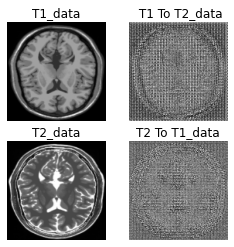

In [39]:
T1_to_T2_data = generator_T2(sample_T1_data)   # Generating T2 from T1 data
T2_to_T1_data = generator_T1(sample_T2_data)   # Generating T1 from T2 data

plt.figure(figsize=(4, 4))

imgs = [sample_T1_data, T1_to_T2_data, sample_T2_data, T2_to_T1_data]
title = ['T1_data', ' T1 To T2_data', 'T2_data', 'T2 To T1_data']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    plt.imshow(imgs[i][0].numpy()[:, :, 0], cmap='gray')
    plt.axis('off')
plt.show()

#### Declare Loss as Binary Cross Entropy
Since Our Discriminator is a classifier

In [40]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)


### Discriminator Loss
It consists of two types of losses
1.    Loss on Real Data
2.    Loss on Fake Data

In [41]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5 # mean of losses

#### Generator Loss
It has only one type of loss - Discriminator Loss on Generated data

In [42]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)



#### Cycle Loss
When we use both of Generators sequentially on a Input Image, we get Cycle Image and the L1 Loss between these two is called Cycle Loss.

In [43]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return 10.0 * loss1

#### Identity Loss
When we provide input image to the Generator such that no translation is needed because the Image is already transformed. Here also we take L1 Loss between Input and Output Image.
|

In [44]:
def identity_loss(real_image, same_image):
    id_loss = tf.reduce_mean(tf.abs(real_image - same_image))       # Averages out all values in the input
    return 2.0 * id_loss   

#### Optimizer 
We use Adam Optimizer to update weights which is a good optimizer to achieve quick learning.

In [45]:
generator_T1_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_T2_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_T1_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_T2_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)


In [46]:
EPOCHS = 150


Checkpoint Initialization

In [47]:
# Directory to keep Checkpoints at each epoch
if not os.path.isdir('training_checkpoints'):
    os.mkdir('training_checkpoints')

checkpoint_path = "./training_checkpoints"

ckpt = tf.train.Checkpoint(generator_T1=generator_T1,
                           generator_T2=generator_T2,
                           discriminator_T1=discriminator_T1,
                           discriminator_T2=discriminator_T2,
                           generator_T1_optimizer=generator_T1_optimizer,
                           generator_T2_optimizer=generator_T2_optimizer,
                           discriminator_T1_optimizer=discriminator_T1_optimizer,
                           discriminator_T2_optimizer=discriminator_T2_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


In [48]:
# Directory to keep Generated Images each epoch
if not os.path.isdir('generated_images'):
    os.mkdir('generated_images')

# Function to show Images output by Generators while Training
def generate_images(model1, test_input1, model2, test_input2, epoch):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(4, 4))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input T1', 'Predicted T2 - Epoch ' + str(epoch), 'Input T2', 'Predicted T1 - Epoch ' + str(epoch)]
    for i in range(4):
        plt.subplot(2, 2, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')

    plt.savefig('./generated_images/image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Training Flow
Below Function performs one Flow of Batch Training <p>
Notice that Identity Loss and Cycle Loss are only used in training Generator and not Discriminator

Sequence of Training Flow


1.   Generate Fake Y and Cycled X
2.   Generate Fake X and Cycled Y
3.   Generate Fake Images through G and F for Identity Loss.
4.   Calculate Discriminator Loss for Disc X and Disc Y on Fake Data for Generator Training.
5.   Calculate Generator Loss on Discriminator.
6.   Calculate Cycled Loss on Cycled Images from step 1 and 2.
7.   Calculate Total Generator Loss - Disc Loss + Cycled Loss + Identity Loss
8.   Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
9.   Calculate the Gradients and update the weight and bias of models.


In [49]:
@tf.function
def train_step(real_T1, real_T2):
    # persistent is set to True because the tape is used more than once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator T2 translates T1 -> T2
        # Generator T1 translates T2 -> T1
        fake_T2 = generator_T2(real_T1, training=True)
        cycled_T1 = generator_T1(fake_T2, training=True)
        
        fake_T1 = generator_T1(real_T2, training=True)
        cycled_T2 = generator_T2(fake_T1, training=True)
        
        # same_x and same_y are used for identity loss.
        same_T1 = generator_T1(real_T1, training=True)
        same_T2 = generator_T2(real_T2, training=True)
        
        disc_real_T1 = discriminator_T1(real_T1, training=True)
        disc_real_T2 = discriminator_T2(real_T2, training=True)
        
        disc_fake_T1 = discriminator_T1(fake_T1, training=True)
        disc_fake_T2 = discriminator_T2(fake_T2, training=True)
        
        # calculate generator loss
        gen_T2_loss = generator_loss(disc_fake_T2)
        gen_T1_loss = generator_loss(disc_fake_T1)
        
        # Calculate cycle loss
        total_cycle_loss = calc_cycle_loss(real_T1, cycled_T1) + calc_cycle_loss(real_T2, cycled_T2)
        
        # Total generator loss = BCE loss + cycle loss + identity loss
        total_gen_T1_loss = gen_T1_loss + total_cycle_loss + identity_loss(real_T1, same_T1)
        total_gen_T2_loss = gen_T2_loss + total_cycle_loss + identity_loss(real_T2, same_T2)
        
        # Discriminator's loss
        disc_T1_loss = discriminator_loss(disc_real_T1, disc_fake_T1)
        disc_T2_loss = discriminator_loss(disc_real_T2, disc_fake_T2)
        
    # Calculate the gradients for generator and discriminator
    generator_T1_gradients = tape.gradient(total_gen_T1_loss, generator_T1.trainable_variables)
    generator_T2_gradients = tape.gradient(total_gen_T2_loss, generator_T2.trainable_variables)
    
    discriminator_T1_gradients = tape.gradient(disc_T1_loss, discriminator_T1.trainable_variables)
    discriminator_T2_gradients = tape.gradient(disc_T2_loss, discriminator_T2.trainable_variables)
    
    # Apply the gradients to the optimizer
    generator_T1_optimizer.apply_gradients(zip(generator_T1_gradients, generator_T1.trainable_variables))
    generator_T2_optimizer.apply_gradients(zip(generator_T2_gradients, generator_T2.trainable_variables))
    
    discriminator_T1_optimizer.apply_gradients(zip(discriminator_T1_gradients, discriminator_T1.trainable_variables))
    discriminator_T2_optimizer.apply_gradients(zip(discriminator_T2_gradients, discriminator_T2.trainable_variables))

#### Train the CycleGAN Model for several Epochs
Loop training function for number of epochs and also show the output at each step. 


2022-05-02 21:39:11.198150: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


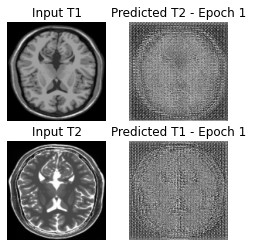

Saving checkpoint for epoch 1 at ./training_checkpoints/ckpt-4


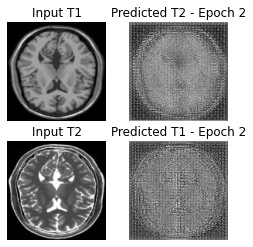

Saving checkpoint for epoch 2 at ./training_checkpoints/ckpt-5


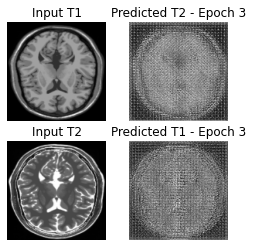

Saving checkpoint for epoch 3 at ./training_checkpoints/ckpt-6


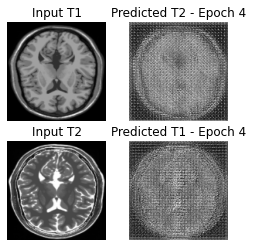

Saving checkpoint for epoch 4 at ./training_checkpoints/ckpt-7


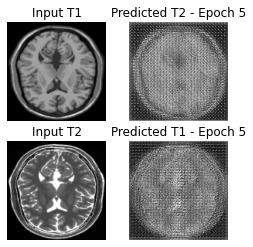

Saving checkpoint for epoch 5 at ./training_checkpoints/ckpt-8


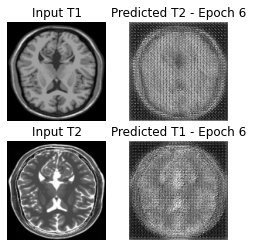

Saving checkpoint for epoch 6 at ./training_checkpoints/ckpt-9


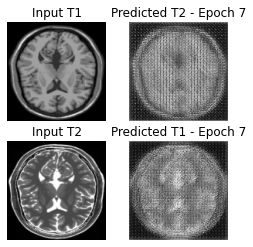

Saving checkpoint for epoch 7 at ./training_checkpoints/ckpt-10


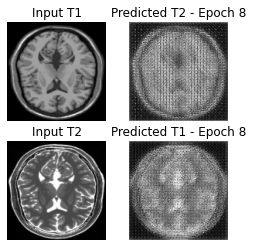

Saving checkpoint for epoch 8 at ./training_checkpoints/ckpt-11


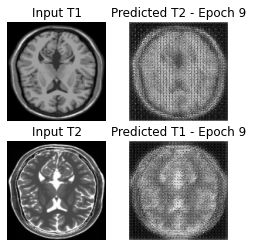

Saving checkpoint for epoch 9 at ./training_checkpoints/ckpt-12


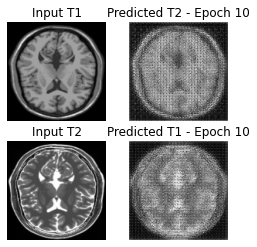

Saving checkpoint for epoch 10 at ./training_checkpoints/ckpt-13


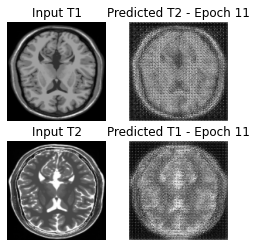

Saving checkpoint for epoch 11 at ./training_checkpoints/ckpt-14


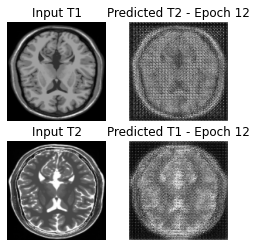

Saving checkpoint for epoch 12 at ./training_checkpoints/ckpt-15


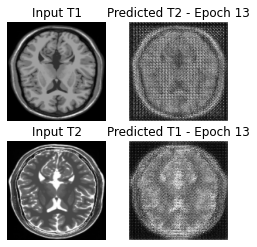

Saving checkpoint for epoch 13 at ./training_checkpoints/ckpt-16


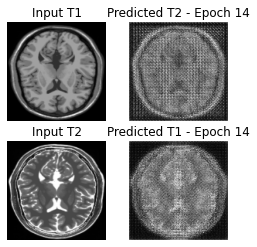

Saving checkpoint for epoch 14 at ./training_checkpoints/ckpt-17


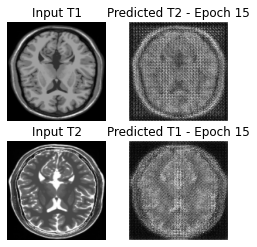

Saving checkpoint for epoch 15 at ./training_checkpoints/ckpt-18


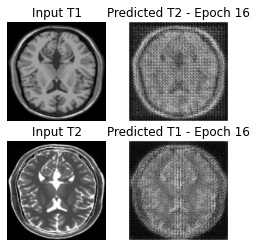

Saving checkpoint for epoch 16 at ./training_checkpoints/ckpt-19


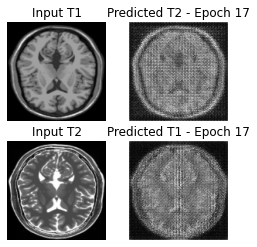

Saving checkpoint for epoch 17 at ./training_checkpoints/ckpt-20


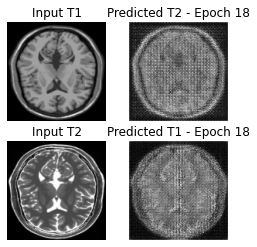

Saving checkpoint for epoch 18 at ./training_checkpoints/ckpt-21


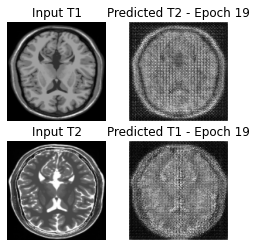

Saving checkpoint for epoch 19 at ./training_checkpoints/ckpt-22


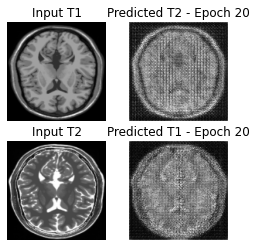

Saving checkpoint for epoch 20 at ./training_checkpoints/ckpt-23


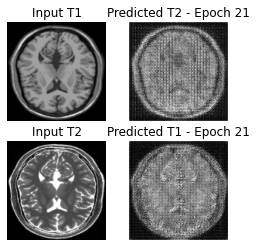

Saving checkpoint for epoch 21 at ./training_checkpoints/ckpt-24


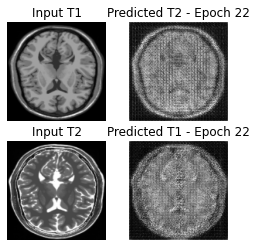

Saving checkpoint for epoch 22 at ./training_checkpoints/ckpt-25


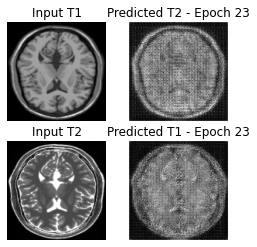

Saving checkpoint for epoch 23 at ./training_checkpoints/ckpt-26


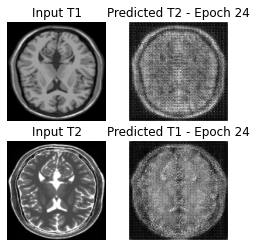

Saving checkpoint for epoch 24 at ./training_checkpoints/ckpt-27


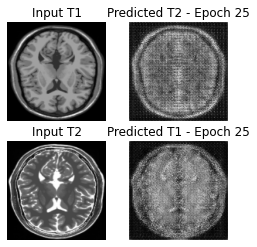

Saving checkpoint for epoch 25 at ./training_checkpoints/ckpt-28


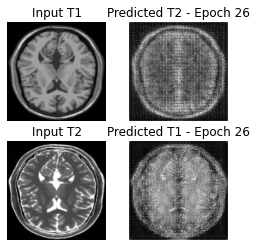

Saving checkpoint for epoch 26 at ./training_checkpoints/ckpt-29


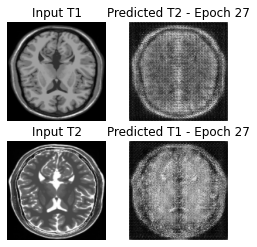

Saving checkpoint for epoch 27 at ./training_checkpoints/ckpt-30


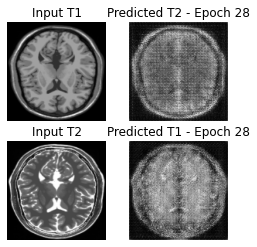

Saving checkpoint for epoch 28 at ./training_checkpoints/ckpt-31


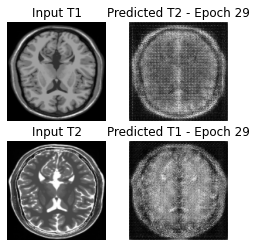

Saving checkpoint for epoch 29 at ./training_checkpoints/ckpt-32


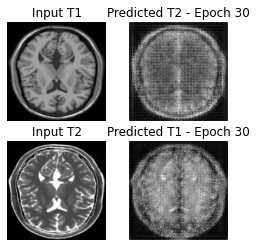

Saving checkpoint for epoch 30 at ./training_checkpoints/ckpt-33


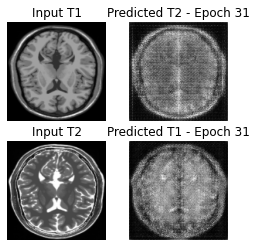

Saving checkpoint for epoch 31 at ./training_checkpoints/ckpt-34


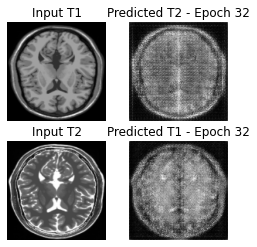

Saving checkpoint for epoch 32 at ./training_checkpoints/ckpt-35


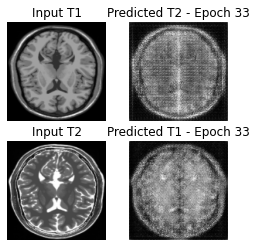

Saving checkpoint for epoch 33 at ./training_checkpoints/ckpt-36


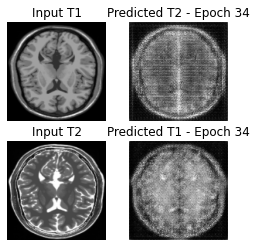

Saving checkpoint for epoch 34 at ./training_checkpoints/ckpt-37


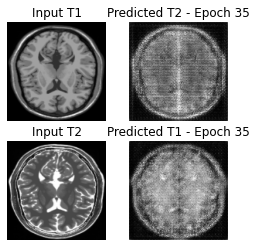

Saving checkpoint for epoch 35 at ./training_checkpoints/ckpt-38


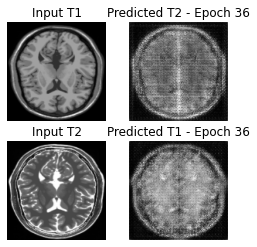

Saving checkpoint for epoch 36 at ./training_checkpoints/ckpt-39


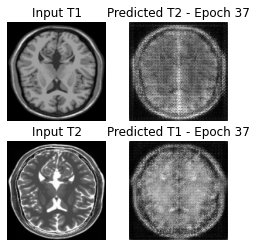

Saving checkpoint for epoch 37 at ./training_checkpoints/ckpt-40


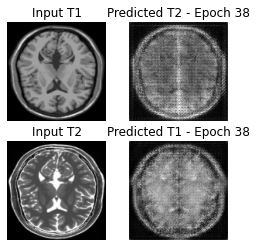

Saving checkpoint for epoch 38 at ./training_checkpoints/ckpt-41


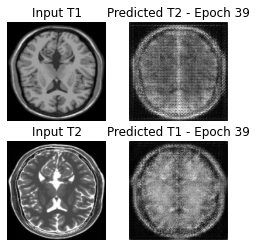

Saving checkpoint for epoch 39 at ./training_checkpoints/ckpt-42


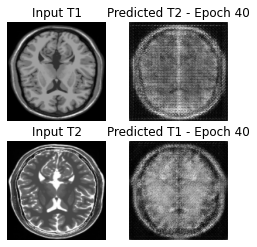

Saving checkpoint for epoch 40 at ./training_checkpoints/ckpt-43


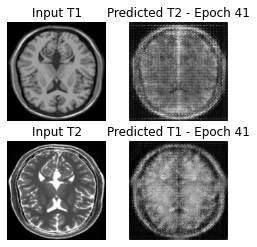

Saving checkpoint for epoch 41 at ./training_checkpoints/ckpt-44


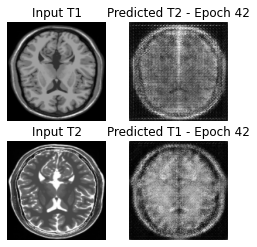

Saving checkpoint for epoch 42 at ./training_checkpoints/ckpt-45


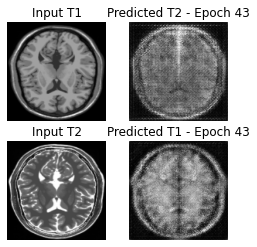

Saving checkpoint for epoch 43 at ./training_checkpoints/ckpt-46


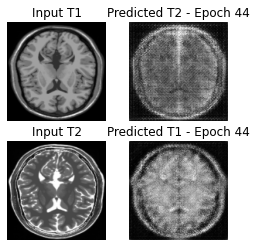

Saving checkpoint for epoch 44 at ./training_checkpoints/ckpt-47


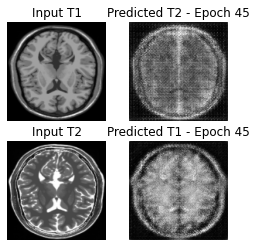

Saving checkpoint for epoch 45 at ./training_checkpoints/ckpt-48


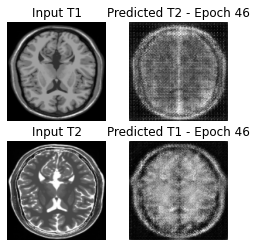

Saving checkpoint for epoch 46 at ./training_checkpoints/ckpt-49


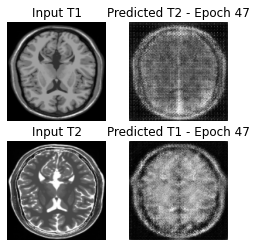

Saving checkpoint for epoch 47 at ./training_checkpoints/ckpt-50


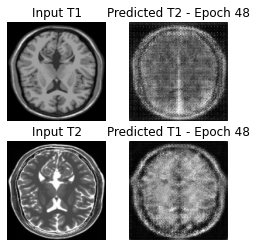

Saving checkpoint for epoch 48 at ./training_checkpoints/ckpt-51


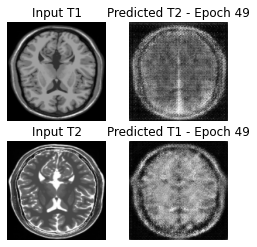

Saving checkpoint for epoch 49 at ./training_checkpoints/ckpt-52


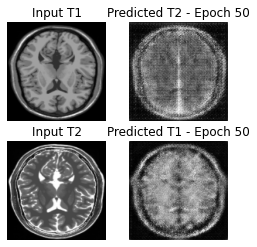

Saving checkpoint for epoch 50 at ./training_checkpoints/ckpt-53


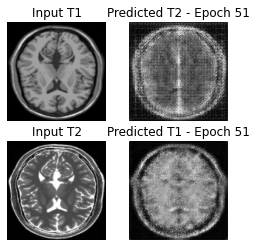

Saving checkpoint for epoch 51 at ./training_checkpoints/ckpt-54


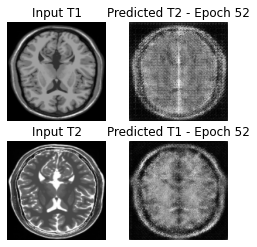

Saving checkpoint for epoch 52 at ./training_checkpoints/ckpt-55


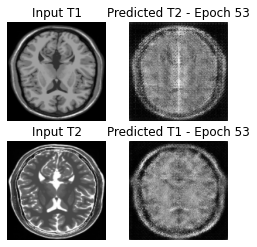

Saving checkpoint for epoch 53 at ./training_checkpoints/ckpt-56


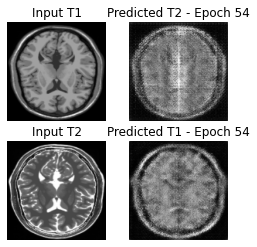

Saving checkpoint for epoch 54 at ./training_checkpoints/ckpt-57


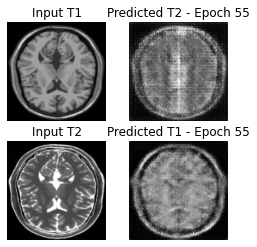

Saving checkpoint for epoch 55 at ./training_checkpoints/ckpt-58


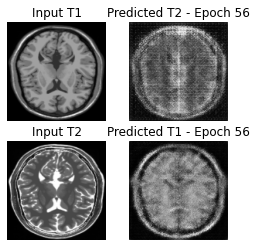

Saving checkpoint for epoch 56 at ./training_checkpoints/ckpt-59


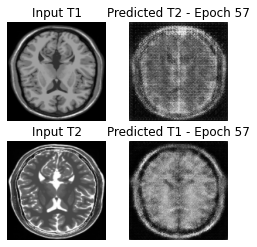

Saving checkpoint for epoch 57 at ./training_checkpoints/ckpt-60


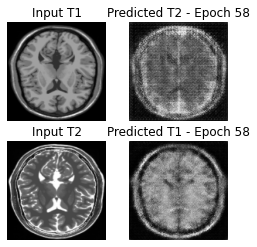

Saving checkpoint for epoch 58 at ./training_checkpoints/ckpt-61


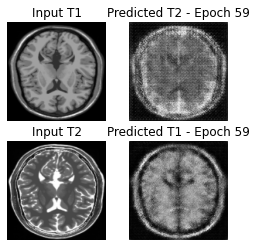

Saving checkpoint for epoch 59 at ./training_checkpoints/ckpt-62


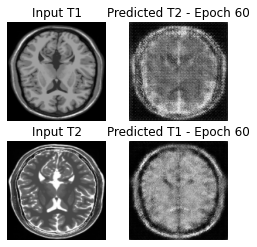

Saving checkpoint for epoch 60 at ./training_checkpoints/ckpt-63


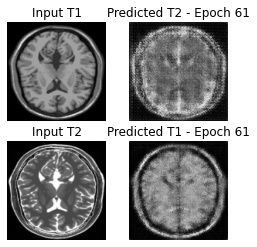

Saving checkpoint for epoch 61 at ./training_checkpoints/ckpt-64


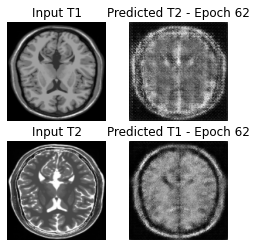

Saving checkpoint for epoch 62 at ./training_checkpoints/ckpt-65


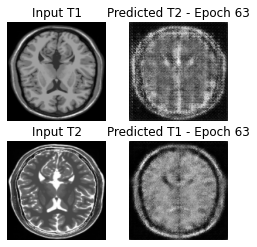

Saving checkpoint for epoch 63 at ./training_checkpoints/ckpt-66


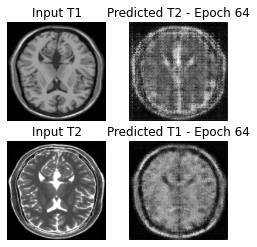

Saving checkpoint for epoch 64 at ./training_checkpoints/ckpt-67


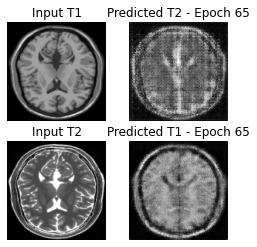

Saving checkpoint for epoch 65 at ./training_checkpoints/ckpt-68


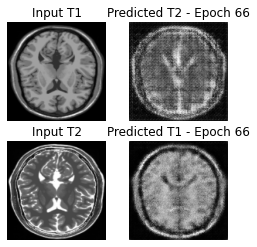

Saving checkpoint for epoch 66 at ./training_checkpoints/ckpt-69


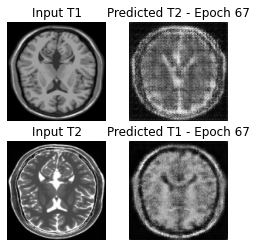

Saving checkpoint for epoch 67 at ./training_checkpoints/ckpt-70


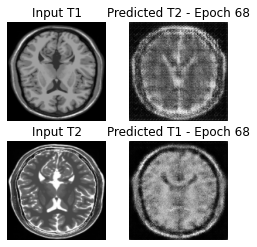

Saving checkpoint for epoch 68 at ./training_checkpoints/ckpt-71


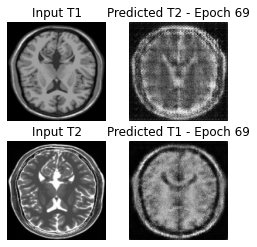

Saving checkpoint for epoch 69 at ./training_checkpoints/ckpt-72


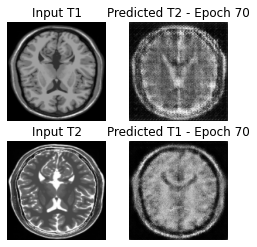

Saving checkpoint for epoch 70 at ./training_checkpoints/ckpt-73


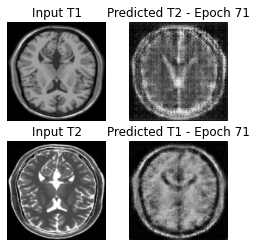

Saving checkpoint for epoch 71 at ./training_checkpoints/ckpt-74


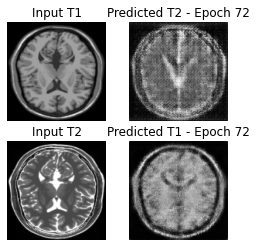

Saving checkpoint for epoch 72 at ./training_checkpoints/ckpt-75


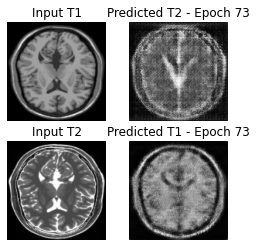

Saving checkpoint for epoch 73 at ./training_checkpoints/ckpt-76


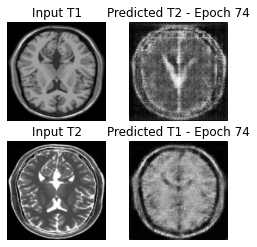

Saving checkpoint for epoch 74 at ./training_checkpoints/ckpt-77


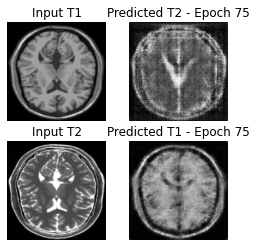

Saving checkpoint for epoch 75 at ./training_checkpoints/ckpt-78


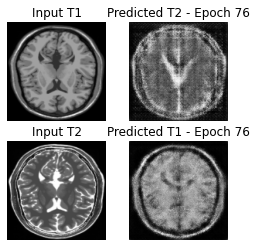

Saving checkpoint for epoch 76 at ./training_checkpoints/ckpt-79


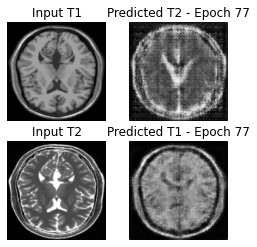

Saving checkpoint for epoch 77 at ./training_checkpoints/ckpt-80


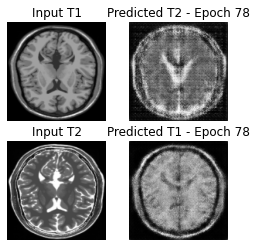

Saving checkpoint for epoch 78 at ./training_checkpoints/ckpt-81


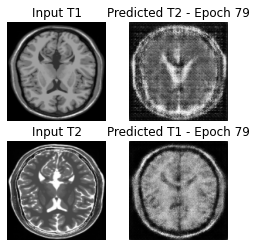

Saving checkpoint for epoch 79 at ./training_checkpoints/ckpt-82


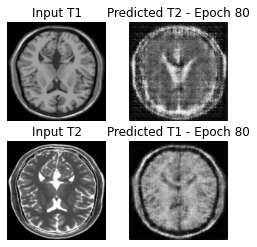

Saving checkpoint for epoch 80 at ./training_checkpoints/ckpt-83


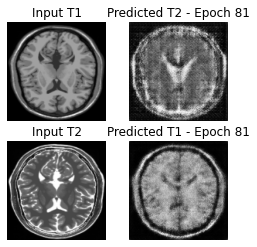

Saving checkpoint for epoch 81 at ./training_checkpoints/ckpt-84


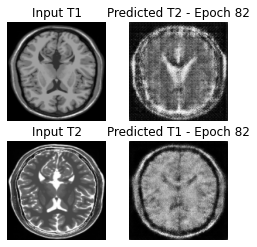

Saving checkpoint for epoch 82 at ./training_checkpoints/ckpt-85


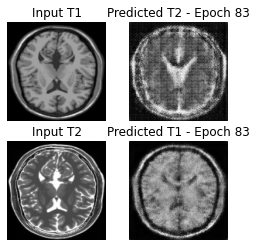

Saving checkpoint for epoch 83 at ./training_checkpoints/ckpt-86


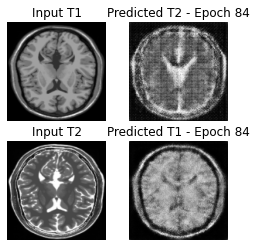

Saving checkpoint for epoch 84 at ./training_checkpoints/ckpt-87


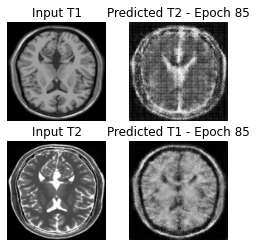

Saving checkpoint for epoch 85 at ./training_checkpoints/ckpt-88


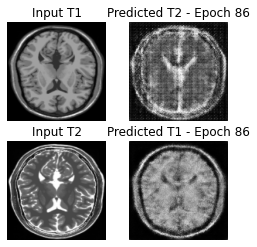

Saving checkpoint for epoch 86 at ./training_checkpoints/ckpt-89


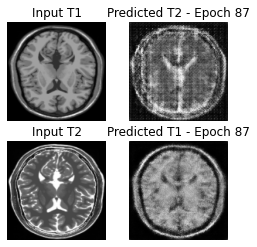

Saving checkpoint for epoch 87 at ./training_checkpoints/ckpt-90


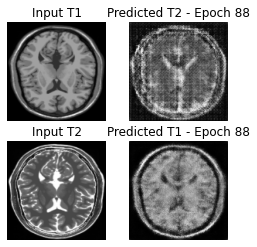

Saving checkpoint for epoch 88 at ./training_checkpoints/ckpt-91


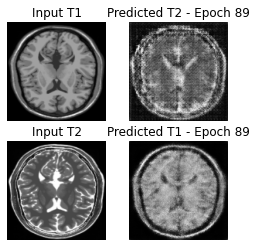

Saving checkpoint for epoch 89 at ./training_checkpoints/ckpt-92


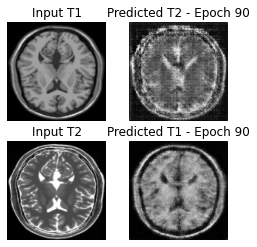

Saving checkpoint for epoch 90 at ./training_checkpoints/ckpt-93


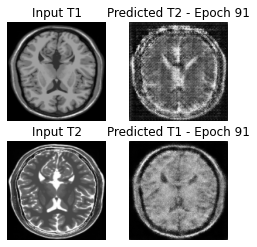

Saving checkpoint for epoch 91 at ./training_checkpoints/ckpt-94


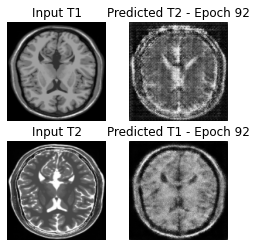

Saving checkpoint for epoch 92 at ./training_checkpoints/ckpt-95


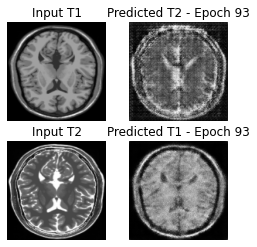

Saving checkpoint for epoch 93 at ./training_checkpoints/ckpt-96


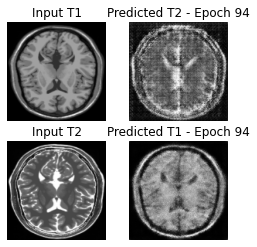

Saving checkpoint for epoch 94 at ./training_checkpoints/ckpt-97


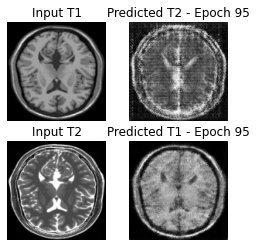

Saving checkpoint for epoch 95 at ./training_checkpoints/ckpt-98


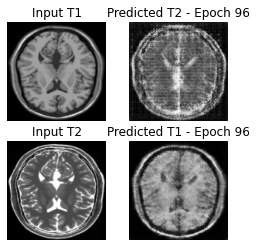

Saving checkpoint for epoch 96 at ./training_checkpoints/ckpt-99


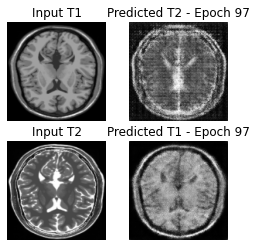

Saving checkpoint for epoch 97 at ./training_checkpoints/ckpt-100


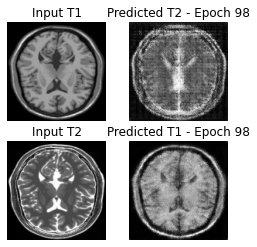

Saving checkpoint for epoch 98 at ./training_checkpoints/ckpt-101


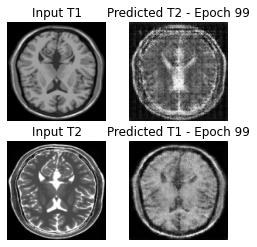

Saving checkpoint for epoch 99 at ./training_checkpoints/ckpt-102


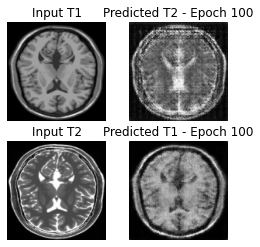

Saving checkpoint for epoch 100 at ./training_checkpoints/ckpt-103


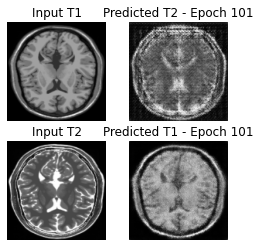

Saving checkpoint for epoch 101 at ./training_checkpoints/ckpt-104


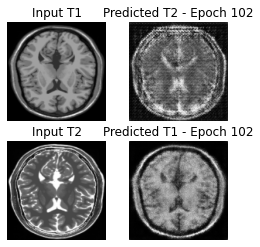

Saving checkpoint for epoch 102 at ./training_checkpoints/ckpt-105


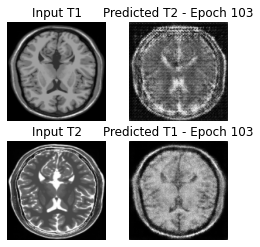

Saving checkpoint for epoch 103 at ./training_checkpoints/ckpt-106


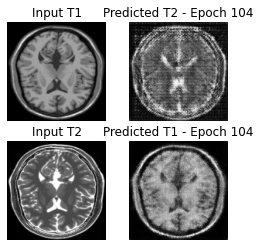

Saving checkpoint for epoch 104 at ./training_checkpoints/ckpt-107


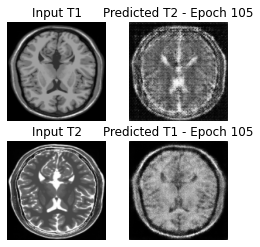

Saving checkpoint for epoch 105 at ./training_checkpoints/ckpt-108


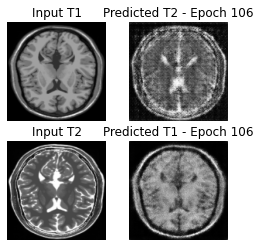

Saving checkpoint for epoch 106 at ./training_checkpoints/ckpt-109


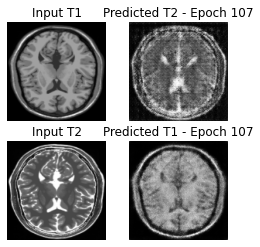

Saving checkpoint for epoch 107 at ./training_checkpoints/ckpt-110


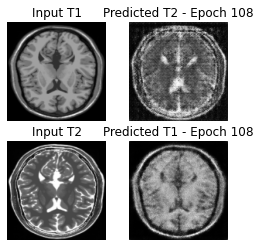

Saving checkpoint for epoch 108 at ./training_checkpoints/ckpt-111


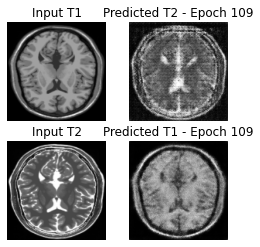

Saving checkpoint for epoch 109 at ./training_checkpoints/ckpt-112


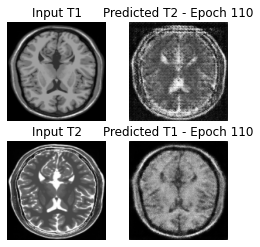

Saving checkpoint for epoch 110 at ./training_checkpoints/ckpt-113


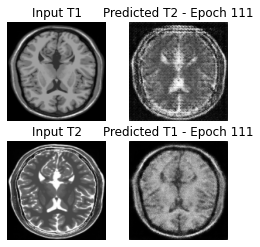

Saving checkpoint for epoch 111 at ./training_checkpoints/ckpt-114


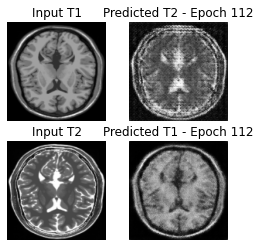

Saving checkpoint for epoch 112 at ./training_checkpoints/ckpt-115


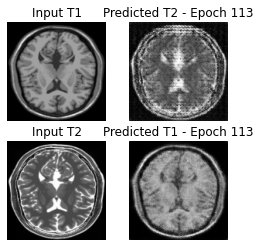

Saving checkpoint for epoch 113 at ./training_checkpoints/ckpt-116


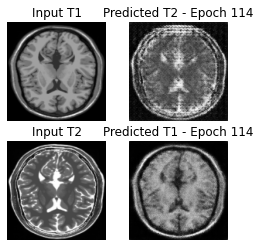

Saving checkpoint for epoch 114 at ./training_checkpoints/ckpt-117


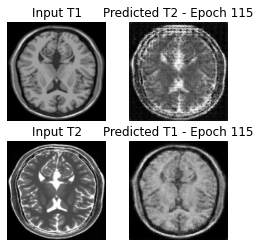

Saving checkpoint for epoch 115 at ./training_checkpoints/ckpt-118


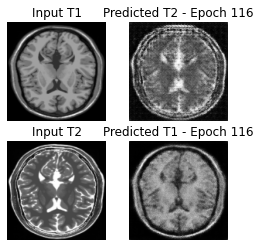

Saving checkpoint for epoch 116 at ./training_checkpoints/ckpt-119


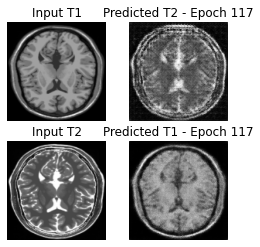

Saving checkpoint for epoch 117 at ./training_checkpoints/ckpt-120


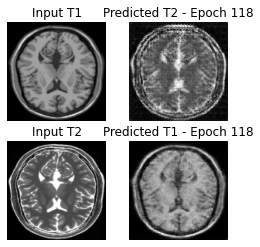

Saving checkpoint for epoch 118 at ./training_checkpoints/ckpt-121


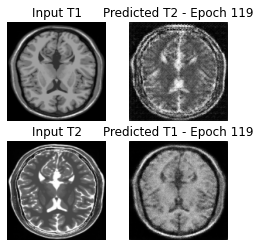

Saving checkpoint for epoch 119 at ./training_checkpoints/ckpt-122


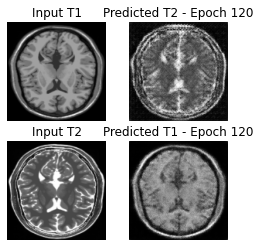

Saving checkpoint for epoch 120 at ./training_checkpoints/ckpt-123


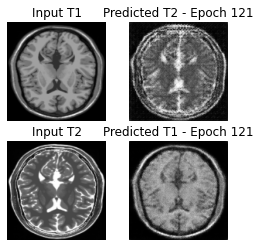

Saving checkpoint for epoch 121 at ./training_checkpoints/ckpt-124


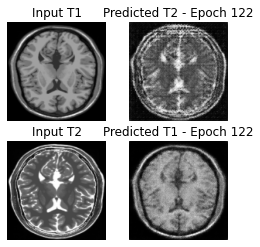

Saving checkpoint for epoch 122 at ./training_checkpoints/ckpt-125


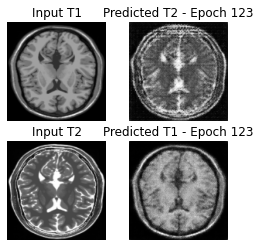

Saving checkpoint for epoch 123 at ./training_checkpoints/ckpt-126


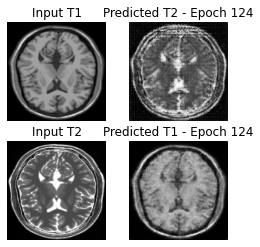

Saving checkpoint for epoch 124 at ./training_checkpoints/ckpt-127


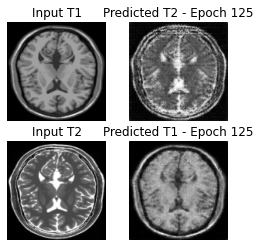

Saving checkpoint for epoch 125 at ./training_checkpoints/ckpt-128


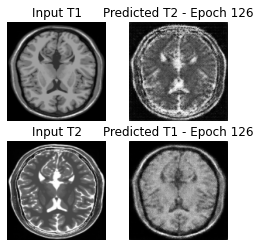

Saving checkpoint for epoch 126 at ./training_checkpoints/ckpt-129


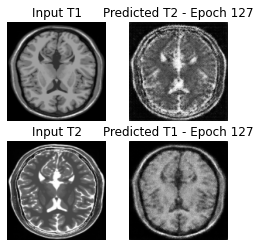

Saving checkpoint for epoch 127 at ./training_checkpoints/ckpt-130


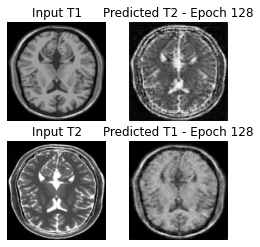

Saving checkpoint for epoch 128 at ./training_checkpoints/ckpt-131


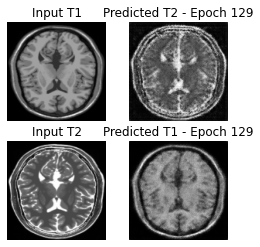

Saving checkpoint for epoch 129 at ./training_checkpoints/ckpt-132


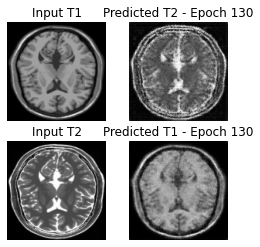

Saving checkpoint for epoch 130 at ./training_checkpoints/ckpt-133


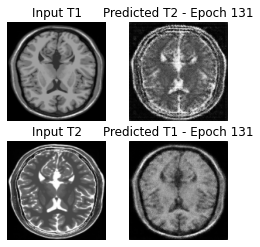

Saving checkpoint for epoch 131 at ./training_checkpoints/ckpt-134


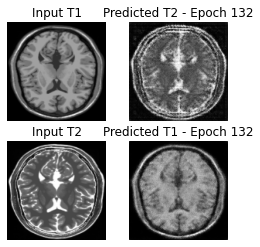

Saving checkpoint for epoch 132 at ./training_checkpoints/ckpt-135


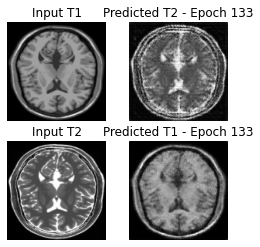

Saving checkpoint for epoch 133 at ./training_checkpoints/ckpt-136


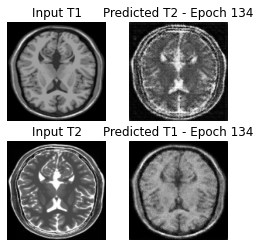

Saving checkpoint for epoch 134 at ./training_checkpoints/ckpt-137


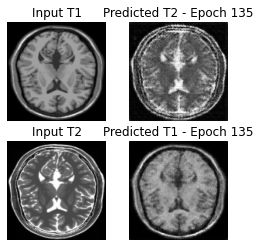

Saving checkpoint for epoch 135 at ./training_checkpoints/ckpt-138


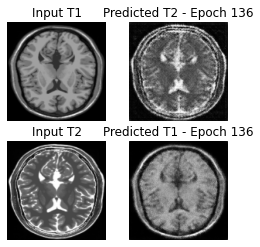

Saving checkpoint for epoch 136 at ./training_checkpoints/ckpt-139


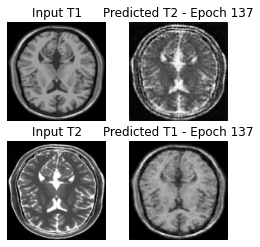

Saving checkpoint for epoch 137 at ./training_checkpoints/ckpt-140


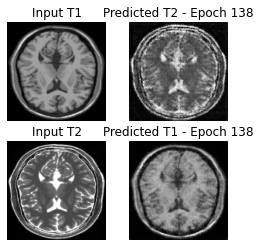

Saving checkpoint for epoch 138 at ./training_checkpoints/ckpt-141


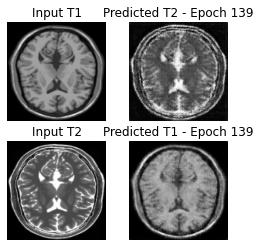

Saving checkpoint for epoch 139 at ./training_checkpoints/ckpt-142


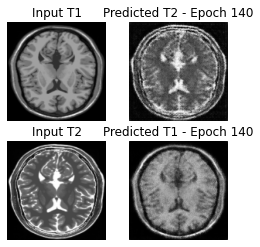

Saving checkpoint for epoch 140 at ./training_checkpoints/ckpt-143


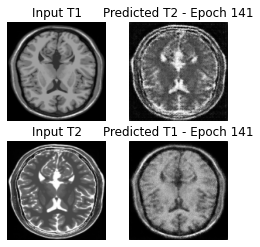

Saving checkpoint for epoch 141 at ./training_checkpoints/ckpt-144


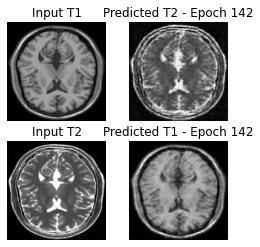

Saving checkpoint for epoch 142 at ./training_checkpoints/ckpt-145


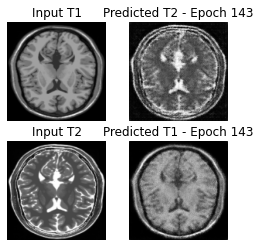

Saving checkpoint for epoch 143 at ./training_checkpoints/ckpt-146


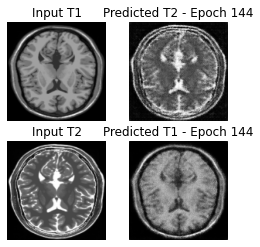

Saving checkpoint for epoch 144 at ./training_checkpoints/ckpt-147


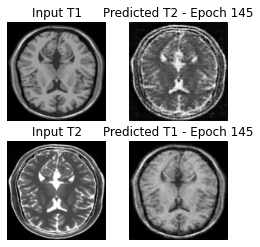

Saving checkpoint for epoch 145 at ./training_checkpoints/ckpt-148


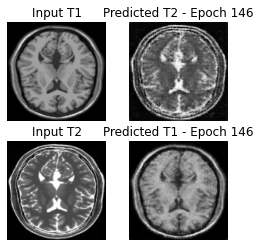

Saving checkpoint for epoch 146 at ./training_checkpoints/ckpt-149


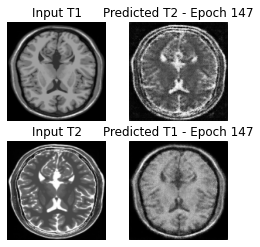

Saving checkpoint for epoch 147 at ./training_checkpoints/ckpt-150


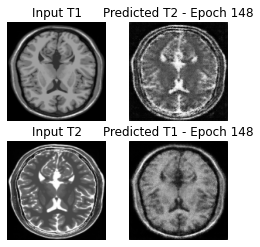

Saving checkpoint for epoch 148 at ./training_checkpoints/ckpt-151


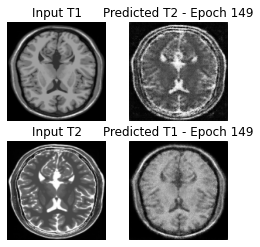

Saving checkpoint for epoch 149 at ./training_checkpoints/ckpt-152


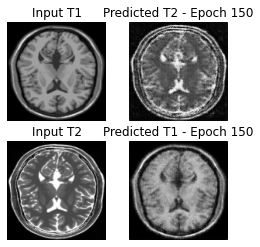

Saving checkpoint for epoch 150 at ./training_checkpoints/ckpt-153


In [50]:
for epoch in range(1, EPOCHS+1):
    for image_x in T1_data:
        for image_y in T2_data:
            train_step(image_x, image_y)
    generate_images(generator_T2, sample_T1_data, generator_T1, sample_T2_data, epoch)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

In [51]:
anim_file = 'MRI_T1_T2_ver.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('./generated_images/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

In [52]:
pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /private/var/folders/fj/clhgrbbn5xsg5b4wcjpffdw40000gn/T/pip-req-build-d5r_dtvj
  Running command git clone -q https://github.com/tensorflow/docs /private/var/folders/fj/clhgrbbn5xsg5b4wcjpffdw40000gn/T/pip-req-build-d5r_dtvj
  Resolved https://github.com/tensorflow/docs to commit 4be05178be80b4a0e41042186bdab3b263895a8a
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=175747 sha256=c8b539de32e9c53f343e928eaa250c84885da1355121902000cbb0d8e15e5f5c
  Stored in directory: /private/var/folders/fj/clhgrbbn5xsg5b4wcjpffdw40000gn/T/pip-ephem-wheel-cache-w8uff30s/wheels/fc/f8/3b/5d21409a59cb1be9b1ade11f682039ced75b84de9dd6a0c8de
Successfully built tensorflow-docs
Note: you may need to restart the kernel to use updated packages.



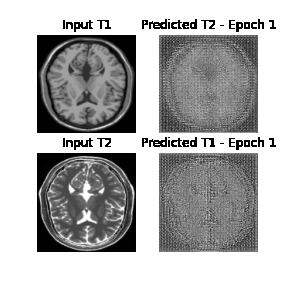

In [54]:
# Visualizing the progress from epoch to epoch 
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

We have successfully translated styles of T1 weighted MRI Images to T2 weighted MRI Images and vice versa. help to provide a better diagnosis with the help of an additional image.